In [1]:
from IPython.display import clear_output
!pip install imutils
clear_output()

from keras.applications.vgg19 import VGG19,preprocess_input
from keras.applications.xception import Xception,preprocess_input
from keras.applications.inception_v3 import InceptionV3 as icv3
from keras.applications.resnet import ResNet50 as rn50

[DATASET](https://www.kaggle.com/datasets/navoneel/brain-mri-images-for-brain-tumor-detection)

[link text]()Code for Reference:

In [2]:
import numpy as np
from tqdm import tqdm
import cv2
import os
import shutil
import itertools
import imutils
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
from plotly import tools

from keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg16 import VGG16, preprocess_input
from keras import layers
from keras.models import Model, Sequential
from keras.optimizers import Adam, RMSprop
from keras.callbacks import EarlyStopping

init_notebook_mode(connected=True)
RANDOM_SEED = 123


In [3]:
!mkdir TRAIN TEST VAL TRAIN/YES TRAIN/NO TEST/YES TEST/NO VAL/YES VAL/NO

In [4]:
from google.colab import drive

In [5]:
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
IMG_PATH = '/content/drive/MyDrive/brain_tumor_dataset_main/'
# split the data by train/val/test
for CLASS in os.listdir(IMG_PATH):
    if not CLASS.startswith('.'):
        IMG_NUM = len(os.listdir(IMG_PATH + CLASS))
        for (n, FILE_NAME) in enumerate(os.listdir(IMG_PATH + CLASS)):
            img = IMG_PATH + CLASS + '/' + FILE_NAME
            if n < 0.2*IMG_NUM:
                shutil.copy(img, 'TEST/' + CLASS.upper() + '/' + FILE_NAME)
            elif n < 0.7*IMG_NUM:
                shutil.copy(img, 'TRAIN/'+ CLASS.upper() + '/' + FILE_NAME)
            else:
                shutil.copy(img, 'VAL/'+ CLASS.upper() + '/' + FILE_NAME)

In [7]:
IMG_PATH = '/content/drive/MyDrive/brain_tumor_dataset_main/'
# split the data by train/val/test
for CLASS in os.listdir(IMG_PATH):
    if not CLASS.startswith('.'):
        IMG_NUM = len(os.listdir(IMG_PATH + CLASS))
        print(IMG_NUM)

155
98


In [8]:
def load_data(dir_path, img_size=(100,100)):
    """
    Load resized images as np.arrays to workspace
    """
    X = []
    y = []
    i = 0
    labels = dict()
    for path in tqdm(sorted(os.listdir(dir_path))):
        if not path.startswith('.'):
            labels[i] = path
            for file in os.listdir(dir_path + path):
                if not file.startswith('.'):
                    img = cv2.imread(dir_path + path + '/' + file)
                    X.append(img)
                    y.append(i)
            i += 1
    X = np.array(X)
    y = np.array(y)
    print(f'{len(X)} images loaded from {dir_path} directory.')
    return X, y, labels



def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.figure(figsize = (6,6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=90)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    cm = np.round(cm,2)
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

In [9]:
TRAIN_DIR = 'TRAIN/'
TEST_DIR = 'TEST/'
VAL_DIR = 'VAL/'
IMG_SIZE = (224,224)

# use predefined function to load the image data into workspace
X_train, y_train, labels = load_data(TRAIN_DIR, IMG_SIZE)
X_test, y_test, _ = load_data(TEST_DIR, IMG_SIZE)
X_val, y_val, _ = load_data(VAL_DIR, IMG_SIZE)

100%|██████████| 2/2 [00:00<00:00,  4.16it/s]
<ipython-input-8-59831cb31691>:18: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



127 images loaded from TRAIN/ directory.


100%|██████████| 2/2 [00:00<00:00,  9.92it/s]


51 images loaded from TEST/ directory.


100%|██████████| 2/2 [00:00<00:00,  8.10it/s]

75 images loaded from VAL/ directory.


In [10]:
y = dict()
y[0] = []
y[1] = []
for set_name in (y_train, y_val, y_test):
    y[0].append(np.sum(set_name == 0))
    y[1].append(np.sum(set_name == 1))

trace0 = go.Bar(
    x=['Train Set', 'Validation Set', 'Test Set'],
    y=y[0],
    name='No',
    marker=dict(color='#33cc33'),
    opacity=0.7
)
trace1 = go.Bar(
    x=['Train Set', 'Validation Set', 'Test Set'],
    y=y[1],
    name='Yes',
    marker=dict(color='red'),
    opacity=0.7
)
data = [trace0, trace1]
layout = go.Layout(
    title='Count of classes in each set',
    xaxis={'title': 'Set'},
    yaxis={'title': 'Count'}
)
fig = go.Figure(data, layout)
fig.show(renderer="colab")


In [11]:
def plot_samples(X, y, labels_dict, n=50):
    """
    Creates a gridplot for desired number of images (n) from the specified set
    """
    for index in range(len(labels_dict)):
        imgs = X[np.argwhere(y == index)][:n]
        j = 10
        i = int(n/j)

        plt.figure(figsize=(15,6))
        c = 1
        for img in imgs:
            plt.subplot(i,j,c)
            plt.imshow(img[0])

            plt.xticks([])
            plt.yticks([])
            c += 1
        plt.suptitle('Tumor: {}'.format(labels_dict[index]))
        plt.show()

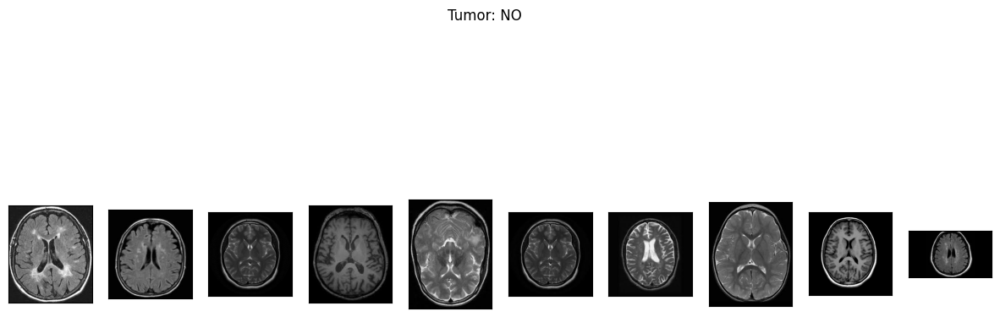

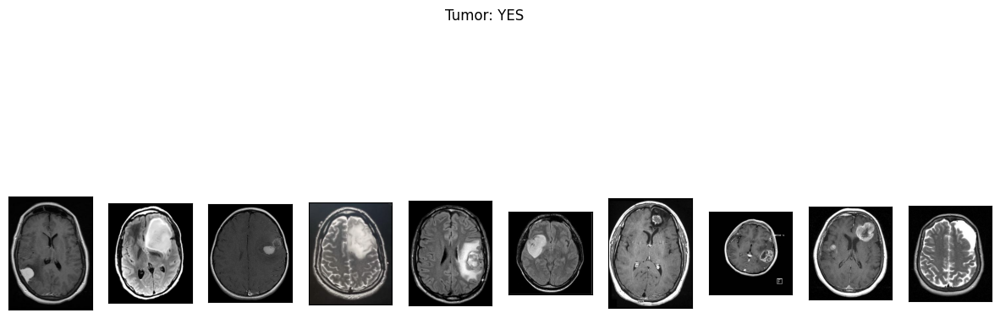

In [12]:
plot_samples(X_train, y_train, labels, 10)

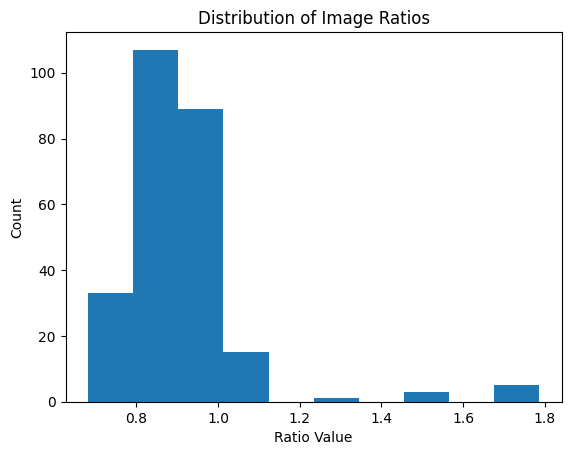

In [13]:
RATIO_LIST = []        # ratio = width/height
for set in (X_train, X_test, X_val):
    for img in set:
        RATIO_LIST.append(img.shape[1]/img.shape[0])

plt.hist(RATIO_LIST)
plt.title('Distribution of Image Ratios')
plt.xlabel('Ratio Value')
plt.ylabel('Count')
plt.show()

In [14]:
def crop_imgs(set_name, add_pixels_value=0):
    """
    Finds the extreme points on the image and crops the rectangular out of them
    """
    set_new = []
    for img in set_name:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        gray = cv2.GaussianBlur(gray, (5, 5), 0)

        # threshold the image, then perform a series of erosions +
        # dilations to remove any small regions of noise
        thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
        thresh = cv2.erode(thresh, None, iterations=2)
        thresh = cv2.dilate(thresh, None, iterations=2)

        # find contours in thresholded image, then grab the largest one
        cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cnts = imutils.grab_contours(cnts)
        c = max(cnts, key=cv2.contourArea)

        # find the extreme points
        extLeft = tuple(c[c[:, :, 0].argmin()][0])
        extRight = tuple(c[c[:, :, 0].argmax()][0])
        extTop = tuple(c[c[:, :, 1].argmin()][0])
        extBot = tuple(c[c[:, :, 1].argmax()][0])

        ADD_PIXELS = add_pixels_value
        new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()
        set_new.append(new_img)

    return np.array(set_new)

In [15]:
img = cv2.imread('/content/drive/MyDrive/brain_tumor_dataset_main/yes/Y108.jpg')
img = cv2.resize(
            img,
            dsize=IMG_SIZE,
            interpolation=cv2.INTER_CUBIC
        )
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
gray = cv2.GaussianBlur(gray, (5, 5), 0)

# threshold the image, then perform a series of erosions +
# dilations to remove any small regions of noise
thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
thresh = cv2.erode(thresh, None, iterations=2)
thresh = cv2.dilate(thresh, None, iterations=2)

# find contours in thresholded image, then grab the largest one
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
c = max(cnts, key=cv2.contourArea)

# find the extreme points
extLeft = tuple(c[c[:, :, 0].argmin()][0])
extRight = tuple(c[c[:, :, 0].argmax()][0])
extTop = tuple(c[c[:, :, 1].argmin()][0])
extBot = tuple(c[c[:, :, 1].argmax()][0])

# add contour on the image
img_cnt = cv2.drawContours(img.copy(), [c], -1, (0, 255, 255), 4)

# add extreme points
img_pnt = cv2.circle(img_cnt.copy(), extLeft, 8, (0, 0, 255), -1)
img_pnt = cv2.circle(img_pnt, extRight, 8, (0, 255, 0), -1)
img_pnt = cv2.circle(img_pnt, extTop, 8, (255, 0, 0), -1)
img_pnt = cv2.circle(img_pnt, extBot, 8, (255, 255, 0), -1)

# crop
ADD_PIXELS = 0
new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

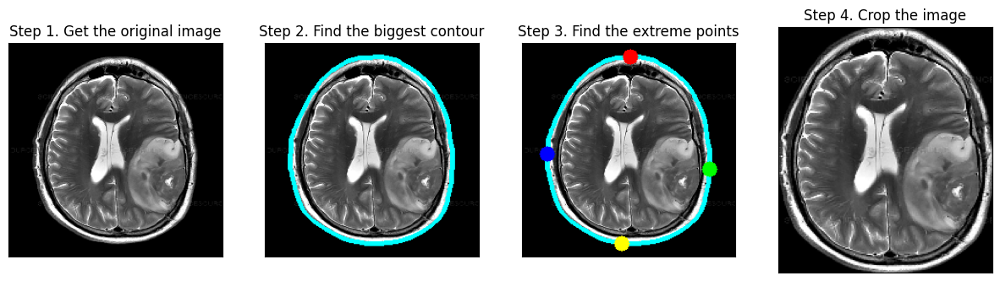

In [16]:
plt.figure(figsize=(15,6))
plt.subplot(141)
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.title('Step 1. Get the original image')
plt.subplot(142)
plt.imshow(img_cnt)
plt.xticks([])
plt.yticks([])
plt.title('Step 2. Find the biggest contour')
plt.subplot(143)
plt.imshow(img_pnt)
plt.xticks([])
plt.yticks([])
plt.title('Step 3. Find the extreme points')
plt.subplot(144)
plt.imshow(new_img)
plt.xticks([])
plt.yticks([])
plt.title('Step 4. Crop the image')
plt.show()

In [17]:
# apply this for each set
X_train_crop = crop_imgs(set_name=X_train)
X_val_crop = crop_imgs(set_name=X_val)
X_test_crop = crop_imgs(set_name=X_test)

<ipython-input-14-65876982ba26>:31: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



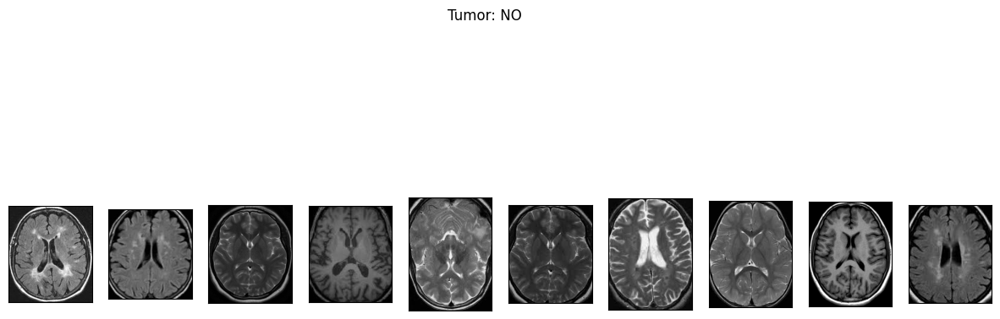

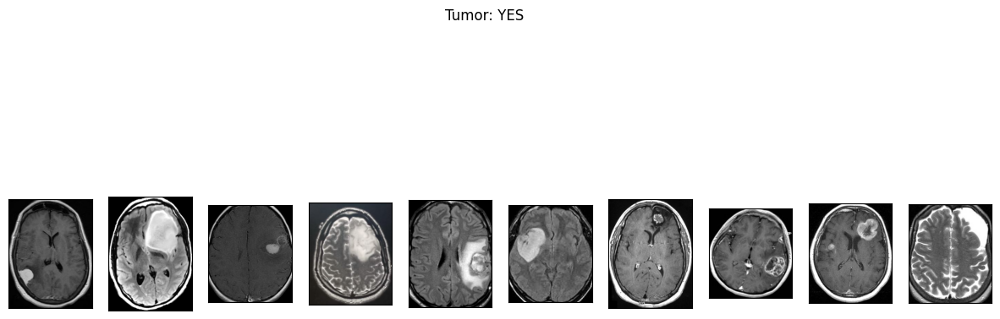

In [18]:
plot_samples(X_train_crop, y_train, labels, 10)

In [19]:
def save_new_images(x_set, y_set, folder_name):
    i = 0
    for (img, imclass) in zip(x_set, y_set):
        if imclass == 0:
            cv2.imwrite(folder_name+'NO/'+str(i)+'.jpg', img)
        else:
            cv2.imwrite(folder_name+'YES/'+str(i)+'.jpg', img)
        i += 1

In [20]:
# saving new images to the folder
!mkdir TRAIN_CROP TEST_CROP VAL_CROP TRAIN_CROP/YES TRAIN_CROP/NO TEST_CROP/YES TEST_CROP/NO VAL_CROP/YES VAL_CROP/NO

save_new_images(X_train_crop, y_train, folder_name='TRAIN_CROP/')
save_new_images(X_val_crop, y_val, folder_name='VAL_CROP/')
save_new_images(X_test_crop, y_test, folder_name='TEST_CROP/')

In [21]:
def preprocess_imgs(set_name, img_size):
    """
    Resize and apply VGG-15 preprocessing
    """
    set_new = []
    for img in set_name:
        img = cv2.resize(
            img,
            dsize=img_size,
            interpolation=cv2.INTER_CUBIC
        )
        set_new.append(preprocess_input(img))
    return np.array(set_new)

In [22]:
X_train_prep = preprocess_imgs(set_name=X_train_crop, img_size=IMG_SIZE)
X_test_prep = preprocess_imgs(set_name=X_test_crop, img_size=IMG_SIZE)
X_val_prep = preprocess_imgs(set_name=X_val_crop, img_size=IMG_SIZE)

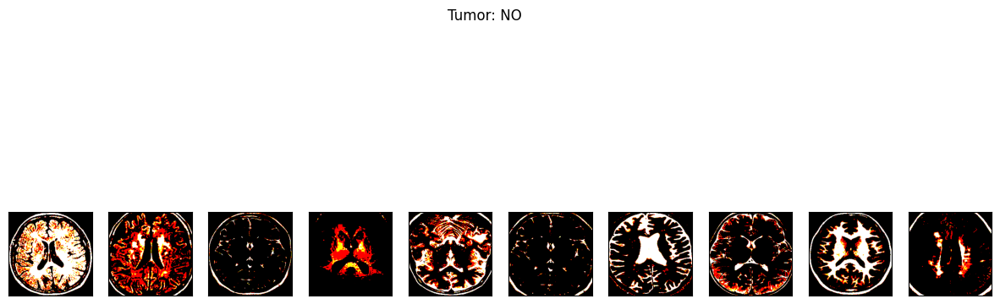

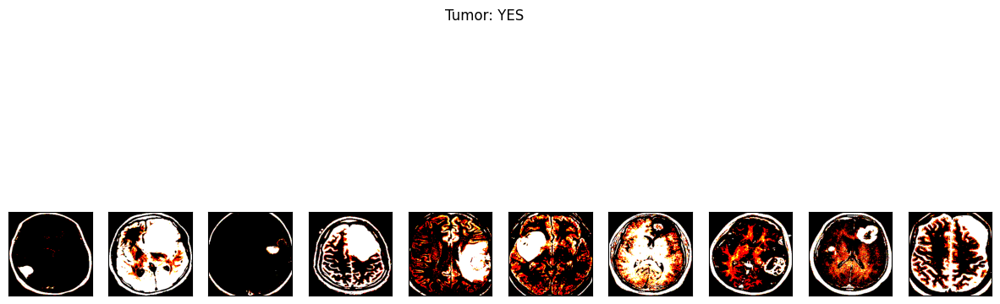

In [23]:
plot_samples(X_train_prep, y_train, labels, 10)

#CNN Model

Data Augmentation

In [24]:
demo_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.05,
    height_shift_range=0.05,
    rescale=1./255,
    shear_range=0.05,
    brightness_range=[0.1, 1.5],
    horizontal_flip=True,
    vertical_flip=True
)

In [25]:
os.mkdir('preview')
x = X_train_crop[0]
x = x.reshape((1,) + x.shape)

i = 0
for batch in demo_datagen.flow(x, batch_size=1, save_to_dir='preview', save_prefix='aug_img', save_format='jpg'):
    i += 1
    if i > 20:
        break

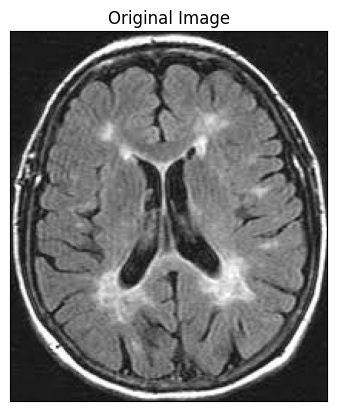

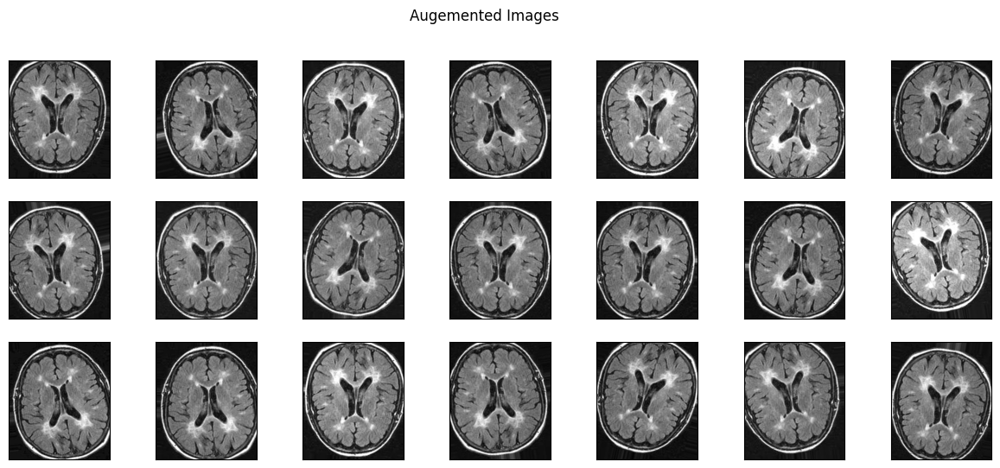

In [26]:
plt.imshow(X_train_crop[0])
plt.xticks([])
plt.yticks([])
plt.title('Original Image')
plt.show()

plt.figure(figsize=(15,6))
i = 1
for img in os.listdir('preview/'):
    img = cv2.imread('preview/' + img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3,7,i)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])
    i += 1
    if i > 3*7:
        break
plt.suptitle('Augemented Images')
plt.show()

In [27]:
!rm -rf preview/

Apply


In [28]:
TRAIN_DIR = 'TRAIN_CROP/'
VAL_DIR = 'VAL_CROP/'

train_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    brightness_range=[0.5, 1.5],
    horizontal_flip=True,
    vertical_flip=True,
    preprocessing_function=preprocess_input
)

test_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    brightness_range=[0.5, 1.5],
    horizontal_flip=True,
    vertical_flip=True,
    preprocessing_function=preprocess_input
)
train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,
    batch_size=20,
    class_mode='binary',
    seed=RANDOM_SEED
)

validation_generator = test_datagen.flow_from_directory(
    VAL_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,
    batch_size=20,
    class_mode='binary',
    seed=RANDOM_SEED
)


Found 127 images belonging to 2 classes.
Found 75 images belonging to 2 classes.


In [29]:
!pip install umap-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.8/90.8 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 9.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.4-py3-none-any.whl size=86770 sha256=90dde2f899c1ea75731c7adc495c723f2926c3adc08a91097ff149ac7974ac4a
  Stored in directory: /root/.cache/pip/wheels/fb/66/29/199acf5784d0f7b8add6d466175ab45506c96e386ed5dd0633
  Created wheel for pynndescent: filename=pynndescent-0.5.10-py3-none-any.whl size=55615 sha256=4fbdca205097966fceb5e4385ee73d769a7af0c09bb93be9db88fd5077456257
  Stored in directory: /root/.cache/pip/wheels/4a/38/5d/f60a40a66a9512b7e5e83517ebc2d1b42d857be97d135f1096
Successfully built umap-learn pynndescent


#Transfer Learning

In [30]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import math
import cv2
import matplotlib.pyplot as plt
import os
import seaborn as sns
import umap
from PIL import Image
from scipy import misc
from os import listdir
from os.path import isfile, join
import numpy as np
from scipy import misc
from random import shuffle
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import tensorflow as tensorflow
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras.utils import to_categorical
from keras.layers import Input


In [31]:
import os
import sys
import random
import warnings

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from tqdm import tqdm
from itertools import chain
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label

from keras.models import Model, load_model
from keras.layers import Input
from tensorflow.keras.layers import Dropout, Lambda
from tensorflow.keras.layers import Conv2D, Conv2DTranspose
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import concatenate
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K
import keras


In [32]:
# load base model
ResNet50_weight_path = 'imagenet'
resnet50_x = rn50(
    weights=ResNet50_weight_path,
    include_top=False,
    input_shape=IMG_SIZE + (3,)
)

94765736/94765736 [==============================] - 0s 0us/step


In [33]:
# load base model
InceptionV3_weight_path = 'imagenet'
inceptionV3 = icv3(
     weights=InceptionV3_weight_path,
    include_top=False,
    input_shape=IMG_SIZE + (3,)
)

87910968/87910968 [==============================] - 1s 0us/step


In [34]:
# load base model
vgg16_weight_path = 'imagenet'
vgg = VGG16(
    weights=vgg16_weight_path,
    include_top=False,
    input_shape=IMG_SIZE + (3,)
)

58889256/58889256 [==============================] - 1s 0us/step


#VGG16 SGD

In [35]:
from keras.optimizers import SGD

NUM_CLASSES = 1

vgg16 = Sequential()
vgg16.add(vgg)
vgg16.add(layers.Dropout(0.3))
vgg16.add(layers.Flatten())
vgg16.add(layers.Dropout(0.5))
vgg16.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

vgg16.layers[0].trainable = False

vgg16.compile(
    loss='binary_crossentropy',
    optimizer=SGD(lr=0.001),
    metrics=['accuracy']
)

vgg16.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 dropout (Dropout)           (None, 7, 7, 512)         0         
                                                                 
 flatten (Flatten)           (None, 25088)             0         
                                                                 
 dropout_1 (Dropout)         (None, 25088)             0         
                                                                 
 dense (Dense)               (None, 1)                 25089     
                                                                 
Total params: 14739777 (56.23 MB)
Trainable params: 25089 (98.00 KB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________


In [36]:
import time

start = time.time()

vgg16_history = vgg16.fit(
    train_generator,
    epochs=50,
    validation_data=validation_generator
)


end = time.time()
print(end - start)

Epoch 1/50
7/7 [==============================] - 29s 2s/step - loss: 228.7002 - accuracy: 0.6142 - val_loss: 334.2641 - val_accuracy: 0.6133
Epoch 2/50
7/7 [==============================] - 3s 526ms/step - loss: 240.1022 - accuracy: 0.6535 - val_loss: 156.4551 - val_accuracy: 0.6933
Epoch 3/50
7/7 [==============================] - 4s 670ms/step - loss: 88.8183 - accuracy: 0.7244 - val_loss: 87.6476 - val_accuracy: 0.7733
Epoch 4/50
7/7 [==============================] - 3s 469ms/step - loss: 90.6070 - accuracy: 0.7323 - val_loss: 161.7786 - val_accuracy: 0.6933
Epoch 5/50
7/7 [==============================] - 3s 487ms/step - loss: 74.2240 - accuracy: 0.8110 - val_loss: 325.6132 - val_accuracy: 0.6267
Epoch 6/50
7/7 [==============================] - 5s 699ms/step - loss: 75.1963 - accuracy: 0.7953 - val_loss: 142.9110 - val_accuracy: 0.7200
Epoch 7/50
7/7 [==============================] - 3s 483ms/step - loss: 79.1616 - accuracy: 0.8110 - val_loss: 138.6098 - val_accuracy: 0.7067


In [37]:
vgg16.save('VGG_model_SGD_70T_10V_20T.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [38]:
import pickle

with open('vgg16_history_SGD_70T_10V_20T.pkl', 'wb') as file:
    pickle.dump(vgg16_history.history, file)


In [39]:
 vgg16 = load_model('VGG_model_SGD_70T_10V_20T.h5')

In [40]:
with open('vgg16_history_SGD_70T_10V_20T.pkl', 'rb') as file:
    history = pickle.load(file)


In [41]:
# validate on val set
predictions = vgg16.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]


2/2 [==============================] - 8s 3s/step


In [42]:
_, train_accuracy = vgg16.evaluate(X_val_prep, y_val, verbose=0)
_, test_accuracy = vgg16.evaluate(X_test_prep, y_test, verbose=0)


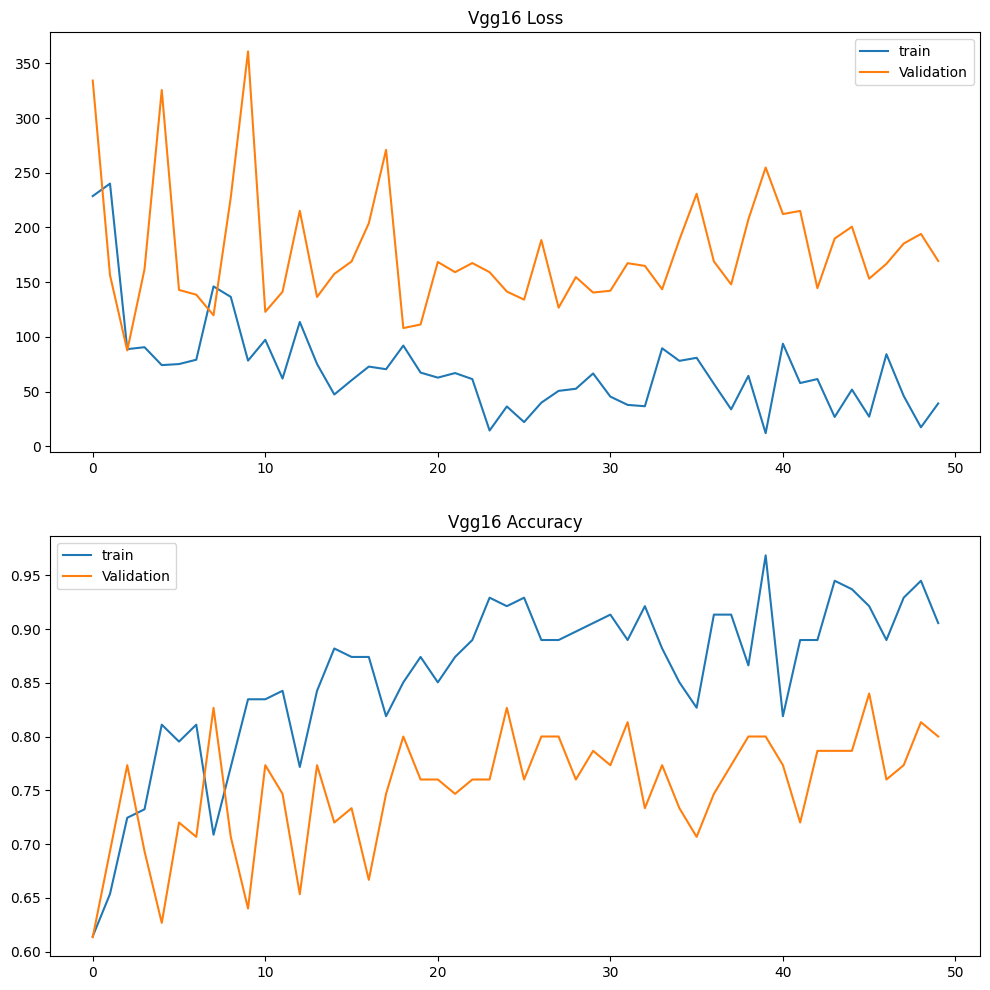

In [43]:
from matplotlib import pyplot

pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('Vgg16 Loss')
pyplot.plot(vgg16_history.history['loss'], label='train')
pyplot.plot(vgg16_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Vgg16 Accuracy')
pyplot.plot(vgg16_history.history['accuracy'], label='train')
pyplot.plot(vgg16_history.history['val_accuracy'], label='Validation')
pyplot.legend()
pyplot.show()


In [44]:
print('Train: %.3f, Test: %.3f' % (train_accuracy, test_accuracy))

Train: 0.813, Test: 0.882


In [45]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

In [46]:
# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.882353
Precision: 0.857143
Recall: 0.967742
F1 score: 0.909091


In [47]:
from sklearn.metrics import roc_auc_score

kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.744147
ROC AUC: 0.858871
[[15  5]
 [ 1 30]]


#VGG16 Adagrad

In [48]:
from keras.optimizers import Adagrad

NUM_CLASSES = 1

vgg16 = Sequential()
vgg16.add(vgg)
vgg16.add(layers.Dropout(0.3))
vgg16.add(layers.Flatten())
vgg16.add(layers.Dropout(0.5))
vgg16.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

vgg16.layers[0].trainable = False

vgg16.compile(
    loss='binary_crossentropy',
    optimizer=Adagrad(lr=0.001),
    metrics=['accuracy']
)

vgg16.summary()


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 dropout_2 (Dropout)         (None, 7, 7, 512)         0         
                                                                 
 flatten_1 (Flatten)         (None, 25088)             0         
                                                                 
 dropout_3 (Dropout)         (None, 25088)             0         
                                                                 
 dense_1 (Dense)             (None, 1)                 25089     
                                                                 
Total params: 14739777 (56.23 MB)
Trainable params: 25089 (98.00 KB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________


In [49]:
import time

start = time.time()

vgg16_history = vgg16.fit(
    train_generator,
    epochs=50,
    validation_data=validation_generator
)

end = time.time()
print(end - start)


Epoch 1/50
7/7 [==============================] - 6s 741ms/step - loss: 6.3017 - accuracy: 0.5354 - val_loss: 2.7249 - val_accuracy: 0.6667
Epoch 2/50
7/7 [==============================] - 3s 483ms/step - loss: 4.9649 - accuracy: 0.6614 - val_loss: 3.4414 - val_accuracy: 0.6933
Epoch 3/50
7/7 [==============================] - 6s 869ms/step - loss: 4.5899 - accuracy: 0.6929 - val_loss: 2.5526 - val_accuracy: 0.7333
Epoch 4/50
7/7 [==============================] - 4s 584ms/step - loss: 3.6992 - accuracy: 0.7480 - val_loss: 3.3739 - val_accuracy: 0.6400
Epoch 5/50
7/7 [==============================] - 3s 473ms/step - loss: 3.2407 - accuracy: 0.7087 - val_loss: 2.8216 - val_accuracy: 0.7067
Epoch 6/50
7/7 [==============================] - 4s 641ms/step - loss: 4.9321 - accuracy: 0.7244 - val_loss: 3.0333 - val_accuracy: 0.6667
Epoch 7/50
7/7 [==============================] - 4s 559ms/step - loss: 2.8327 - accuracy: 0.6772 - val_loss: 2.2101 - val_accuracy: 0.6667
Epoch 8/50
7/7 [====

In [50]:
vgg16.save('VGG_model_Adagrad_70T_10V_20T.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [51]:
import pickle

with open('vgg16_history_Adagrad_70T_10V_20T.pkl', 'wb') as file:
    pickle.dump(vgg16_history.history, file)


In [52]:
vgg16 = load_model('VGG_model_Adagrad_70T_10V_20T.h5')


In [53]:
with open('vgg16_history_Adagrad_70T_10V_20T.pkl', 'rb') as file:
    history = pickle.load(file)


In [54]:
# validate on val set
predictions = vgg16.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]


2/2 [==============================] - 0s 111ms/step


In [55]:
_, train_accuracy = vgg16.evaluate(X_val_prep, y_val, verbose=0)
_, test_accuracy = vgg16.evaluate(X_test_prep, y_test, verbose=0)


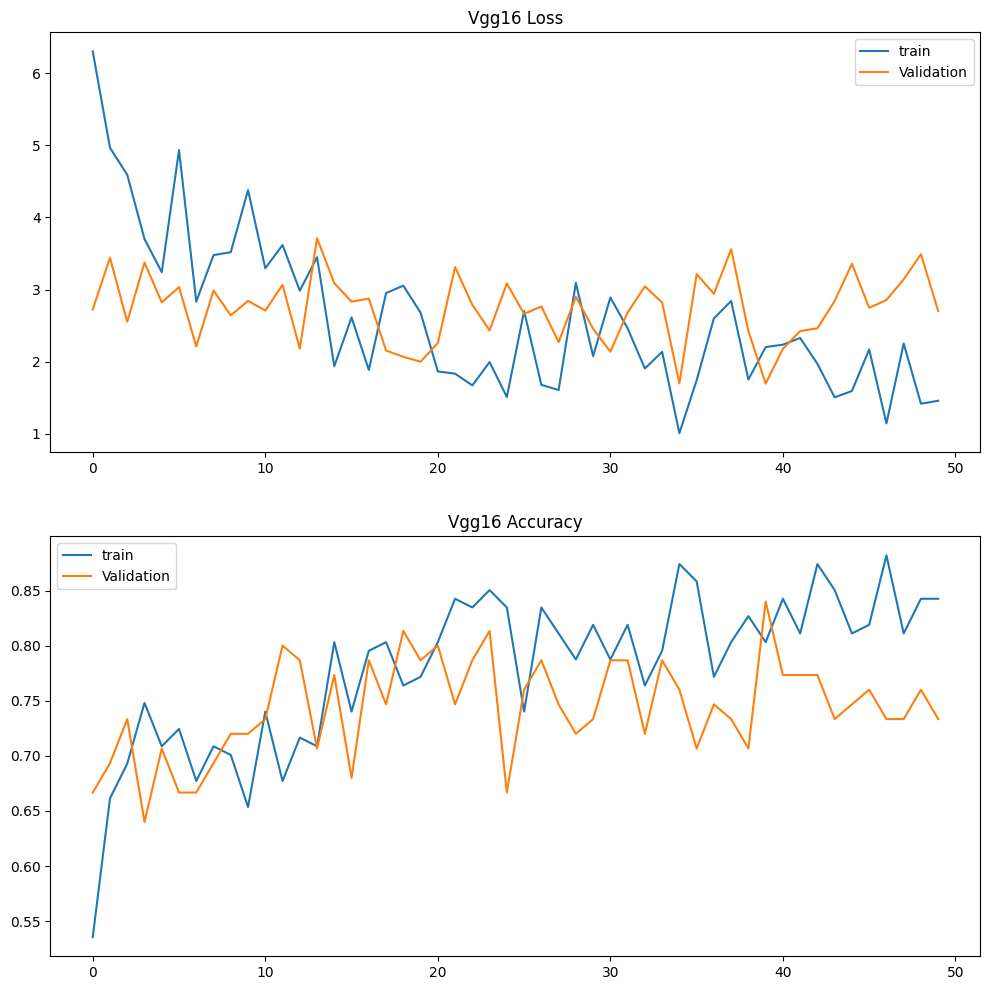

In [56]:
from matplotlib import pyplot

pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('Vgg16 Loss')
pyplot.plot(vgg16_history.history['loss'], label='train')
pyplot.plot(vgg16_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Vgg16 Accuracy')
pyplot.plot(vgg16_history.history['accuracy'], label='train')
pyplot.plot(vgg16_history.history['val_accuracy'], label='Validation')
pyplot.legend()
pyplot.show()

In [57]:
print('Train: %.3f, Test: %.3f' % (train_accuracy, test_accuracy))

Train: 0.800, Test: 0.843


In [58]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

In [59]:
# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.843137
Precision: 0.848485
Recall: 0.903226
F1 score: 0.875000


In [60]:
from sklearn.metrics import roc_auc_score

kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.665025
ROC AUC: 0.826613
[[15  5]
 [ 3 28]]


#VGG16 FTRL

In [61]:
from keras.optimizers import Ftrl

NUM_CLASSES = 1

vgg16 = Sequential()
vgg16.add(vgg)
vgg16.add(layers.Dropout(0.3))
vgg16.add(layers.Flatten())
vgg16.add(layers.Dropout(0.5))
vgg16.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

vgg16.layers[0].trainable = False

vgg16.compile(
    loss='binary_crossentropy',
    optimizer=Ftrl(lr=0.001),
    metrics=['accuracy']
)

vgg16.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 dropout_4 (Dropout)         (None, 7, 7, 512)         0         
                                                                 
 flatten_2 (Flatten)         (None, 25088)             0         
                                                                 
 dropout_5 (Dropout)         (None, 25088)             0         
                                                                 
 dense_2 (Dense)             (None, 1)                 25089     
                                                                 
Total params: 14739777 (56.23 MB)
Trainable params: 25089 (98.00 KB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________


In [62]:
import time

start = time.time()

vgg16_history = vgg16.fit(
    train_generator,
    epochs=50,
    validation_data=validation_generator
)


end = time.time()
print(end - start)

Epoch 1/50
7/7 [==============================] - 5s 533ms/step - loss: 4.6594 - accuracy: 0.6457 - val_loss: 3.3029 - val_accuracy: 0.6400
Epoch 2/50
7/7 [==============================] - 3s 486ms/step - loss: 2.4162 - accuracy: 0.6772 - val_loss: 3.0590 - val_accuracy: 0.5867
Epoch 3/50
7/7 [==============================] - 5s 733ms/step - loss: 2.8479 - accuracy: 0.7008 - val_loss: 2.4761 - val_accuracy: 0.7200
Epoch 4/50
7/7 [==============================] - 3s 472ms/step - loss: 2.5999 - accuracy: 0.6772 - val_loss: 2.2403 - val_accuracy: 0.6933
Epoch 5/50
7/7 [==============================] - 3s 477ms/step - loss: 2.2313 - accuracy: 0.7244 - val_loss: 2.8957 - val_accuracy: 0.7333
Epoch 6/50
7/7 [==============================] - 5s 715ms/step - loss: 2.2041 - accuracy: 0.7638 - val_loss: 2.2349 - val_accuracy: 0.7733
Epoch 7/50
7/7 [==============================] - 4s 609ms/step - loss: 2.6962 - accuracy: 0.8110 - val_loss: 2.3222 - val_accuracy: 0.6933
Epoch 8/50
7/7 [====

In [63]:
vgg16.save('VGG_model_FTRL_70T_10V_20T.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [64]:
import pickle

with open('vgg16_history_FTRL_70T_10V_20T.pkl', 'wb') as file:
    pickle.dump(vgg16_history.history, file)


In [65]:
vgg16 = load_model('VGG_model_FTRL_70T_10V_20T.h5')

In [66]:
with open('vgg16_history_FTRL_70T_10V_20T.pkl', 'rb') as file:
    history = pickle.load(file)

In [67]:
# validate on val set
predictions = vgg16.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

2/2 [==============================] - 0s 152ms/step


In [68]:
_, train_accuracy = vgg16.evaluate(X_val_prep, y_val, verbose=0)
_, test_accuracy = vgg16.evaluate(X_test_prep, y_test, verbose=0)

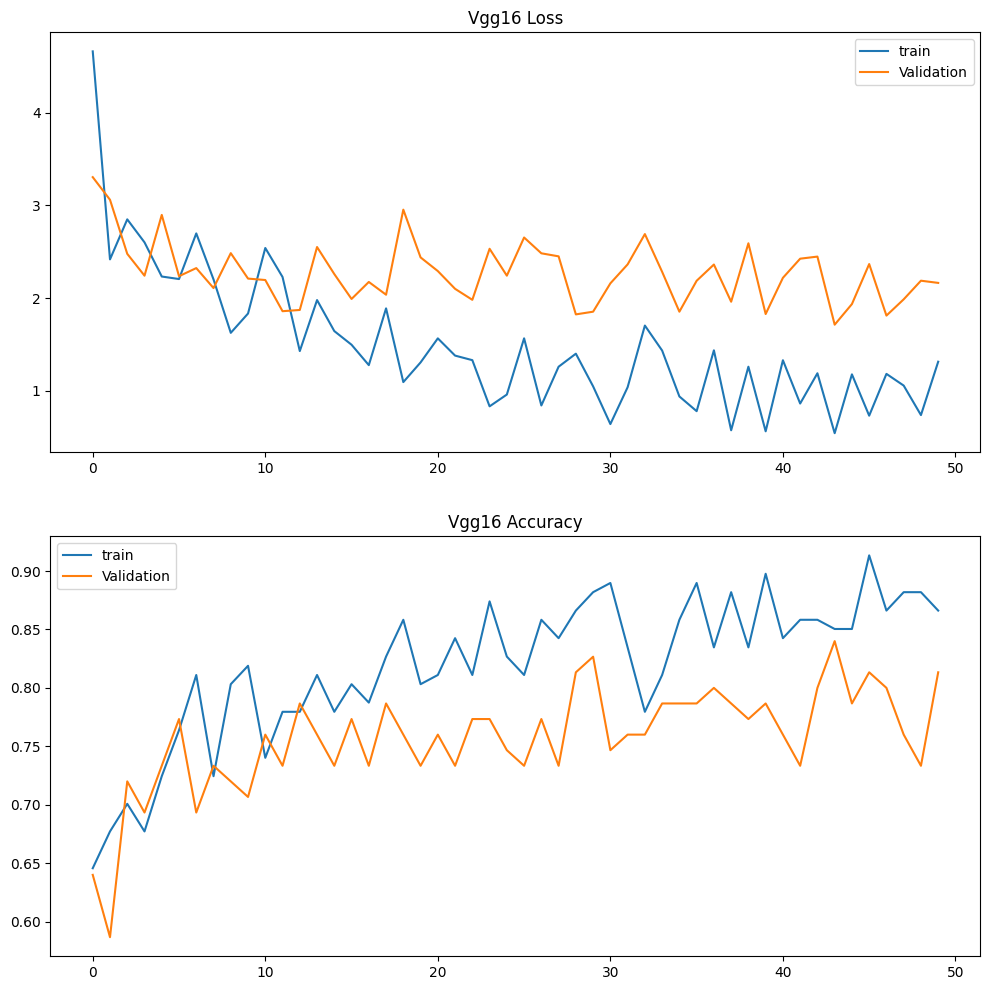

In [69]:
from matplotlib import pyplot

pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('Vgg16 Loss')
pyplot.plot(vgg16_history.history['loss'], label='train')
pyplot.plot(vgg16_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Vgg16 Accuracy')
pyplot.plot(vgg16_history.history['accuracy'], label='train')
pyplot.plot(vgg16_history.history['val_accuracy'], label='Validation')
pyplot.legend()
pyplot.show()

In [70]:
print('Train: %.3f, Test: %.3f' % (train_accuracy, test_accuracy))

Train: 0.773, Test: 0.843


In [71]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

In [72]:
# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.843137
Precision: 0.828571
Recall: 0.935484
F1 score: 0.878788


In [73]:
from sklearn.metrics import roc_auc_score

kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.658863
ROC AUC: 0.817742
[[14  6]
 [ 2 29]]


#VGG-16 Adam

In [74]:
!pip install Pillow

553467096/553467096 [==============================] - 6s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
Total params: 1792 (7.00 KB)
Trainable params: 1792 (7.00 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
1/1 [==============================] - 0s 295ms/step


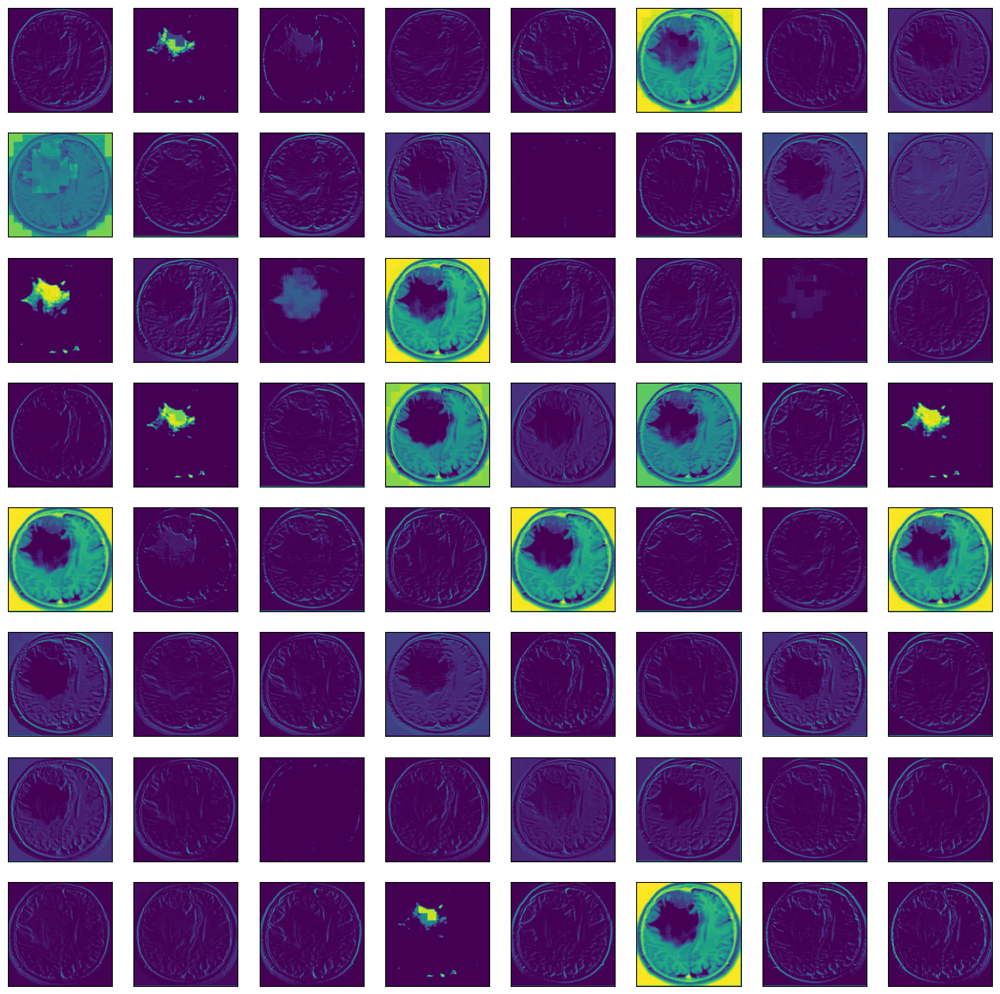

In [75]:
# plot feature map of first conv layer for given image
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims


f = plt.figure(figsize=(16,16))
# load the modelf = plt.figure(figsize=(10,3))
model = VGG16()
# redefine model to output right after the first hidden layer
model = Model(inputs=model.inputs, outputs=model.layers[1].output)
model.summary()
# load the image with the required shape
# convert the image to an array
img = img_to_array(X_val_prep[43])
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot all 64 maps in an 8x8 squares
square = 8
ix = 1
for _ in range(square):
	for _ in range(square):
		# specify subplot and turn of axis
		ax = pyplot.subplot(square, square, ix)
		ax.set_xticks([])
		ax.set_yticks([])
		# plot filter channel in grayscale
		pyplot.imshow(feature_maps[0, :, :, ix-1], cmap='viridis')
		ix += 1
# show the figure
pyplot.show()


In [76]:
NUM_CLASSES = 1

vgg16 = Sequential()
vgg16.add(vgg)
vgg16.add(layers.Dropout(0.3))
vgg16.add(layers.Flatten())
vgg16.add(layers.Dropout(0.5))
vgg16.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

vgg16.layers[0].trainable = False

vgg16.compile(
    loss='binary_crossentropy',
    optimizer=Adam(learning_rate=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, amsgrad=False),
    metrics=['accuracy']
)
vgg16.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 dropout_6 (Dropout)         (None, 7, 7, 512)         0         
                                                                 
 flatten_3 (Flatten)         (None, 25088)             0         
                                                                 
 dropout_7 (Dropout)         (None, 25088)             0         
                                                                 
 dense_3 (Dense)             (None, 1)                 25089     
                                                                 
Total params: 14739777 (56.23 MB)
Trainable params: 25089 (98.00 KB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________


1/1 [==============================] - 1s 846ms/step


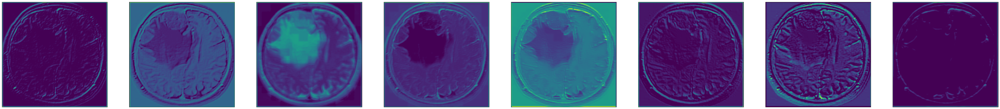

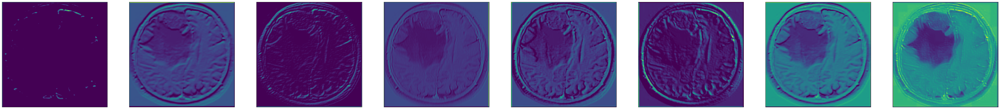

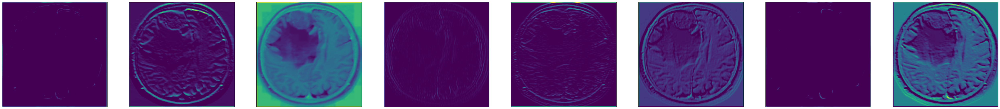

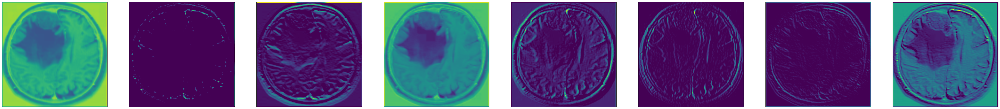

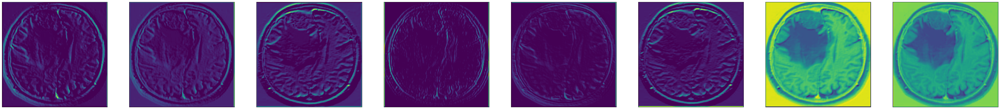

...

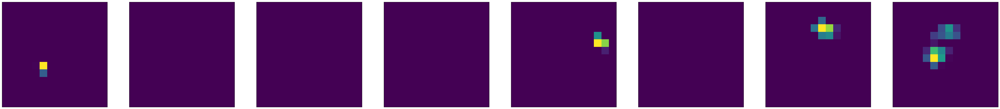

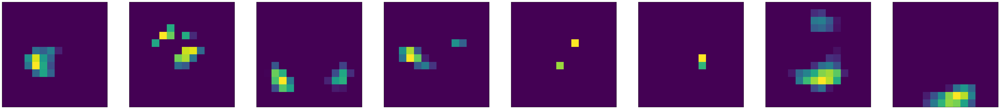

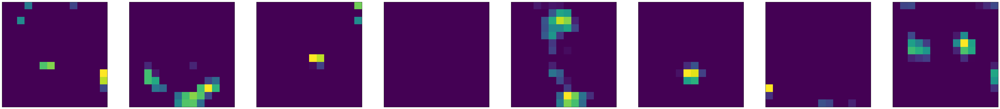

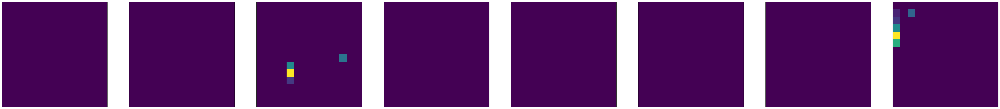

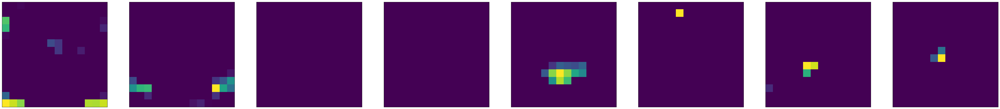

In [77]:
# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from keras.models import Model
import matplotlib.pyplot as plt
from numpy import expand_dims




# load the model
model = VGG16()
# redefine model to output right after the first hidden layer
ixs = [2, 5, 9, 13, 17]
outputs = [model.layers[i].output for i in ixs]
model = Model(inputs=model.inputs, outputs=outputs)
# load the image with the required shape
# convert the image to an array
img = img_to_array(X_val_prep[43])
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		plt.figure(figsize=(64,64))
		for _ in range(square):


			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])

			# plot filter channel in grayscale
			plt.imshow(fmap[0, :, :, ix-1], cmap='viridis')
			ix += 1
	# show the figure


	plt.show()

In [79]:
from tensorflow.keras.optimizers import Adam

vgg16.compile(
    loss='binary_crossentropy',
    optimizer=Adam(learning_rate=0.0003),
    metrics=['accuracy']
)


In [80]:
import time

start = time.time()

vgg16_history = vgg16.fit(
    train_generator,
    epochs=50,
    validation_data=validation_generator
)


end = time.time()
print(end - start)

Epoch 1/50
7/7 [==============================] - 6s 514ms/step - loss: 4.5563 - accuracy: 0.5748 - val_loss: 2.8285 - val_accuracy: 0.6533
Epoch 2/50
7/7 [==============================] - 3s 469ms/step - loss: 4.5197 - accuracy: 0.6693 - val_loss: 3.6006 - val_accuracy: 0.6533
Epoch 3/50
7/7 [==============================] - 4s 563ms/step - loss: 4.7557 - accuracy: 0.6535 - val_loss: 3.0918 - val_accuracy: 0.7200
Epoch 4/50
7/7 [==============================] - 3s 474ms/step - loss: 3.4644 - accuracy: 0.7244 - val_loss: 2.4763 - val_accuracy: 0.7333
Epoch 5/50
7/7 [==============================] - 5s 749ms/step - loss: 3.9999 - accuracy: 0.7323 - val_loss: 3.7621 - val_accuracy: 0.7200
Epoch 6/50
7/7 [==============================] - 3s 534ms/step - loss: 3.3858 - accuracy: 0.7323 - val_loss: 2.6768 - val_accuracy: 0.7333
Epoch 7/50
7/7 [==============================] - 3s 475ms/step - loss: 3.3169 - accuracy: 0.7480 - val_loss: 3.3128 - val_accuracy: 0.7733
Epoch 8/50
7/7 [====

In [81]:
vgg16.save('VGG_model_70T_10V_20T.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [82]:
import pickle

with open('vgg16_history_70T_10V_20T.pkl', 'wb') as file:
    pickle.dump(vgg16_history.history, file)


#Calculate Metric

In [83]:
# validate on val set
predictions = vgg16.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

_, train_accuracy = vgg16.evaluate(X_val_prep, y_val, verbose=0)
_, test_accuracy = vgg16.evaluate(X_test_prep, y_test, verbose=0)

2/2 [==============================] - 0s 157ms/step


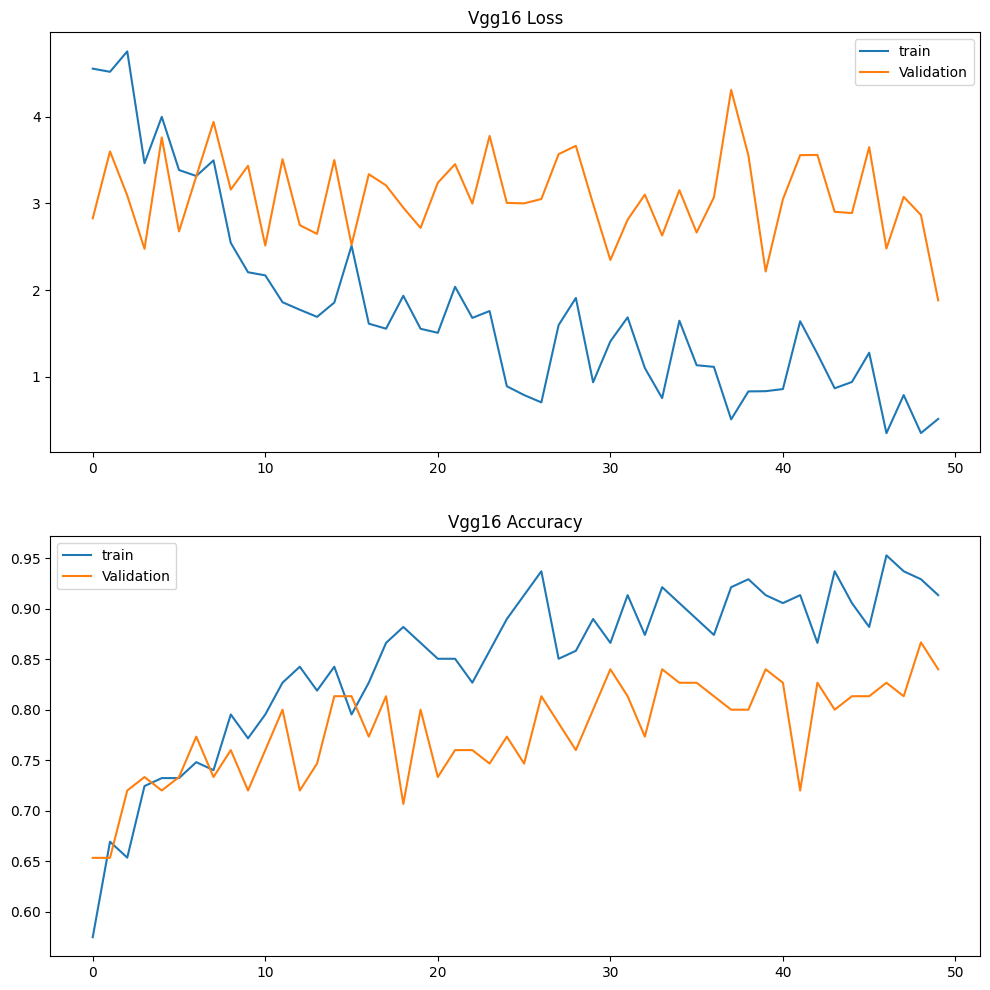

In [84]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('Vgg16 Loss')
pyplot.plot(vgg16_history.history['loss'], label='train')
pyplot.plot(vgg16_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Vgg16 Accuracy')
pyplot.plot(vgg16_history.history['accuracy'], label='train')
pyplot.plot(vgg16_history.history['val_accuracy'], label='Validation')
pyplot.legend()
pyplot.show()

In [85]:
print('Train: %.3f, Test: %.3f' % (train_accuracy, test_accuracy))

Train: 0.853, Test: 0.882


In [86]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.882353
Precision: 0.878788
Recall: 0.935484
F1 score: 0.906250


In [87]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.748768
ROC AUC: 0.867742
[[16  4]
 [ 2 29]]


#Inceotion V3

In [88]:


NUM_CLASSES = 1

inception_v3 = Sequential()
inception_v3.add(inceptionV3)
inception_v3.add(layers.Dropout(0.3))
inception_v3.add(layers.Flatten())
inception_v3.add(layers.Dropout(0.5))
inception_v3.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

inception_v3.layers[0].trainable = False

inception_v3.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(learning_rate=1e-4),
    metrics=['accuracy']
)

inception_v3.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 5, 5, 2048)        21802784  
                                                                 
 dropout_8 (Dropout)         (None, 5, 5, 2048)        0         
                                                                 
 flatten_4 (Flatten)         (None, 51200)             0         
                                                                 
 dropout_9 (Dropout)         (None, 51200)             0         
                                                                 
 dense_4 (Dense)             (None, 1)                 51201     
                                                                 
Total params: 21853985 (83.37 MB)
Trainable params: 51201 (200.00 KB)
Non-trainable params: 21802784 (83.17 MB)
_________________________________________________________________


In [89]:
import time

start = time.time()

inception_v3_history = inception_v3.fit_generator(
    train_generator,
    epochs=50,
    validation_data=validation_generator
)

end = time.time()
print(end - start)

<ipython-input-89-7a813deb2534>:5: UserWarning:

`Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.



Epoch 1/50
7/7 [==============================] - 13s 1s/step - loss: 15.9134 - accuracy: 0.5118 - val_loss: 4.5234 - val_accuracy: 0.6800
Epoch 2/50
7/7 [==============================] - 3s 465ms/step - loss: 13.2517 - accuracy: 0.5354 - val_loss: 7.7377 - val_accuracy: 0.6133
Epoch 3/50
7/7 [==============================] - 3s 466ms/step - loss: 9.9954 - accuracy: 0.6535 - val_loss: 9.7975 - val_accuracy: 0.5200
Epoch 4/50
7/7 [==============================] - 5s 769ms/step - loss: 13.4440 - accuracy: 0.5197 - val_loss: 10.9278 - val_accuracy: 0.5867
Epoch 5/50
7/7 [==============================] - 4s 486ms/step - loss: 9.6860 - accuracy: 0.6220 - val_loss: 8.7454 - val_accuracy: 0.6267
Epoch 6/50
7/7 [==============================] - 3s 459ms/step - loss: 11.6532 - accuracy: 0.5433 - val_loss: 6.1626 - val_accuracy: 0.5467
Epoch 7/50
7/7 [==============================] - 5s 823ms/step - loss: 9.9954 - accuracy: 0.6063 - val_loss: 5.6935 - val_accuracy: 0.5733
Epoch 8/50
7/7 [=

In [90]:
inception_v3.save('Inception_v3_model_70T_10V_20T.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [91]:
import pickle

with open('Inception_v3_history_70T_10V_20T.pkl', 'wb') as file:
    pickle.dump(inception_v3_history.history, file)


#Calculate Metric

In [92]:
# validate on val set
predictions = inception_v3.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

_, train_accuracy = inception_v3.evaluate(X_val_prep, y_val, verbose=0)
_, test_accuracy = inception_v3.evaluate(X_test_prep, y_test, verbose=0)


2/2 [==============================] - 4s 1s/step


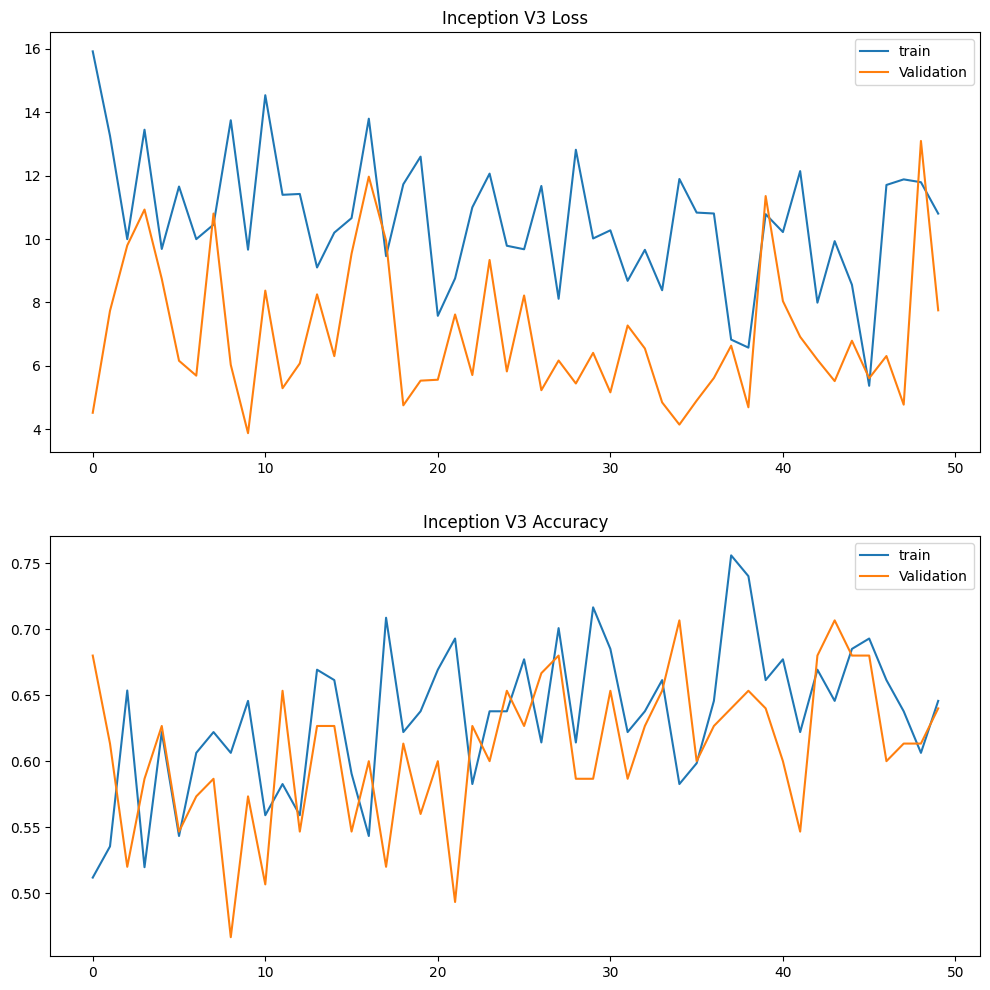

In [93]:
pyplot.figure(figsize=(12,12))
# plot loss during training
pyplot.subplot(211)
pyplot.title('Inception V3 Loss')
pyplot.plot(inception_v3_history.history['loss'], label='train')
pyplot.plot(inception_v3_history.history['val_loss'], label='Validation')
pyplot.legend()
# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Inception V3 Accuracy')
pyplot.plot(inception_v3_history.history['accuracy'], label='train')
pyplot.plot(inception_v3_history.history['val_accuracy'], label='Validation')
pyplot.legend()
pyplot.show()


In [94]:
print('Train: %.3f, Test: %.3f' % (train_accuracy, test_accuracy))


Train: 0.600, Test: 0.667


In [95]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)


Accuracy: 0.666667
Precision: 0.659091
Recall: 0.935484
F1 score: 0.773333


In [96]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.209663
ROC AUC: 0.592742
[[ 5 15]
 [ 2 29]]


#Resnet 50

In [98]:
NUM_CLASSES = 1

resnet50 = Sequential()
resnet50.add(resnet50_x)
resnet50.add(layers.Dropout(0.3))
resnet50.add(layers.Flatten())
resnet50.add(layers.Dropout(0.5))
resnet50.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

resnet50.layers[0].trainable = False

resnet50.compile(
    loss='binary_crossentropy',
    optimizer=RMSprop(lr=1e-4),
    metrics=['accuracy']
)

resnet50.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 dropout_12 (Dropout)        (None, 7, 7, 2048)        0         
                                                                 
 flatten_6 (Flatten)         (None, 100352)            0         
                                                                 
 dropout_13 (Dropout)        (None, 100352)            0         
                                                                 
 dense_6 (Dense)             (None, 1)                 100353    
                                                                 
Total params: 23688065 (90.36 MB)
Trainable params: 100353 (392.00 KB)
Non-trainable params: 23587712 (89.98 MB)
_________________________________________________________________


In [99]:
import time

start = time.time()

resnet50_history = resnet50.fit_generator(
    train_generator,
    epochs=50,
    validation_data=validation_generator
)

end = time.time()
print(end - start)

<ipython-input-99-b839d87a32d9>:5: UserWarning:

`Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.



Epoch 1/50
7/7 [==============================] - 15s 2s/step - loss: 10.9258 - accuracy: 0.6378 - val_loss: 19.0037 - val_accuracy: 0.3867
Epoch 2/50
7/7 [==============================] - 4s 552ms/step - loss: 5.9176 - accuracy: 0.6614 - val_loss: 6.1411 - val_accuracy: 0.5467
Epoch 3/50
7/7 [==============================] - 3s 462ms/step - loss: 2.0478 - accuracy: 0.8031 - val_loss: 2.4367 - val_accuracy: 0.7867
Epoch 4/50
7/7 [==============================] - 3s 470ms/step - loss: 1.9588 - accuracy: 0.8504 - val_loss: 1.7171 - val_accuracy: 0.8267
Epoch 5/50
7/7 [==============================] - 5s 734ms/step - loss: 2.5366 - accuracy: 0.8110 - val_loss: 1.6377 - val_accuracy: 0.8267
Epoch 6/50
7/7 [==============================] - 3s 467ms/step - loss: 0.6990 - accuracy: 0.9134 - val_loss: 2.7912 - val_accuracy: 0.7333
Epoch 7/50
7/7 [==============================] - 3s 510ms/step - loss: 0.3787 - accuracy: 0.9291 - val_loss: 2.3589 - val_accuracy: 0.8400
Epoch 8/50
7/7 [====

In [100]:
resnet50.save('Resnet50_70T_10V_20T.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [127]:
import pickle

with open('Resnet50_history_70T_10V_20T.pkl', 'wb') as file:
    pickle.dump(resnet50_history.history, file)


In [131]:
vgg16 = load_model('Resnet50_70T_10V_20T.h5')
with open('Resnet50_history_70T_10V_20T.pkl', 'rb') as file:
    history = pickle.load(file)


#Calculate Metric

In [102]:
# validate on val set
predictions = resnet50.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

_, train_accuracy = resnet50.evaluate(X_val_prep, y_val, verbose=0)
_, test_accuracy = resnet50.evaluate(X_test_prep, y_test, verbose=0)


2/2 [==============================] - 3s 882ms/step


In [132]:
import matplotlib.pyplot as pyplot

# Assuming that you have the 'resnet50_history' object containing training history

pyplot.figure(figsize=(12, 12))

# plot loss during training
pyplot.subplot(211)
pyplot.title('Resnet50 Loss')
pyplot.plot(resnet50_history.history['loss'], label='Train Loss')
pyplot.plot(resnet50_history.history['val_loss'], label='Validation Loss')
pyplot.legend()

# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Resnet50 Accuracy')
pyplot.plot(resnet50_history.history['accuracy'], label='Train Accuracy')
pyplot.plot(resnet50_history.history['val_accuracy'], label='Validation Accuracy')
pyplot.legend()

pyplot.show()


In [104]:

print('Train: %.3f, Test: %.3f' % (train_accuracy, test_accuracy))

Train: 0.773, Test: 0.784


In [105]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)


Accuracy: 0.784314
Precision: 0.750000
Recall: 0.967742
F1 score: 0.845070


In [106]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.508326
ROC AUC: 0.733871
[[10 10]
 [ 1 30]]


#Model Performance

In [107]:
history_1= vgg16_history
history_2=inception_v3_history
history_3=resnet50_history

In [108]:
def ModelGraphTrainngSummary(history,N,model_name):
    # set the matplotlib backend so figures can be saved in the background
    # plot the training loss and accuracy
    import sys
    import matplotlib
    print("Generating plots...")
    sys.stdout.flush()
    matplotlib.use("Agg")
    matplotlib.pyplot.style.use("ggplot")
    matplotlib.pyplot.figure()
    matplotlib.pyplot.plot(np.arange(0, N), history.history["loss"], label="train_loss")
    matplotlib.pyplot.plot(np.arange(0, N), history.history["val_loss"], label="val_loss")
    #matplotlib.pyplot.plot(np.arange(0, N), history.history["acc"], label="train_acc")
    #matplotlib.pyplot.plot(np.arange(0, N), history.history["val_acc"], label="val_acc")
    matplotlib.pyplot.title("Training Loss and Accuracy on Brain Tumor Classification")
    matplotlib.pyplot.xlabel("Epoch #")
    matplotlib.pyplot.ylabel("Loss/Accuracy of "+model_name)
    matplotlib.pyplot.legend(loc="lower left")
    matplotlib.pyplot.savefig("plot.png")

In [109]:
def ModelGraphTrainngSummaryAccuracy(history,N,model_name):
    # set the matplotlib backend so figures can be saved in the background
    # plot the training loss and accuracy
    import sys
    import matplotlib
    print("Generating plots...")
    sys.stdout.flush()
    matplotlib.use("Agg")
    matplotlib.pyplot.style.use("ggplot")
    matplotlib.pyplot.figure()
    #matplotlib.pyplot.plot(np.arange(0, N), history.history["loss"], label="train_loss")
    #matplotlib.pyplot.plot(np.arange(0, N), history.history["val_loss"], label="val_loss")
    matplotlib.pyplot.plot(np.arange(0, N), history.history["accuracy"], label="train_accuracy")
    matplotlib.pyplot.plot(np.arange(0, N), history.history["val_accuracy"], label="val_accuracy")
    matplotlib.pyplot.title("Training Loss and Accuracy on Brain Tumor Classification")
    matplotlib.pyplot.xlabel("Epoch #")
    matplotlib.pyplot.ylabel("Accuracy of "+ model_name)
    matplotlib.pyplot.legend(loc="lower left")
    matplotlib.pyplot.savefig("plot.png")

In [119]:
for x_model in [{'name': 'VGG-16', 'history': history_1, 'model': vgg16},
                {'name': 'Inception_v3', 'history': history_2, 'model': inception_v3},
                {'name': 'Resnet', 'history': history_3, 'model': resnet50}]:
    num_epochs = len(x_model['history'].history['loss'])  # Get the actual number of epochs
    ModelGraphTrainngSummary(x_model['history'], num_epochs, x_model['name'])
    ModelGraphTrainngSummaryAccuracy(x_model['history'], num_epochs, x_model['name'])

    # Validate on val set
    predictions = x_model['model'].predict(X_val_prep)
    predictions = [1 if x > 0.5 else 0 for x in predictions]

    accuracy = accuracy_score(y_val, predictions)
    print(f'{x_model["name"]} Validation Accuracy = {accuracy:.2f}')

    confusion_mtx = confusion_matrix(y_val, predictions)
    cm = plot_confusion_matrix(confusion_mtx, classes=list(labels.items()), normalize=False)


Generating plots...
Generating plots...
3/3 [==============================] - 1s 150ms/step
VGG-16 Validation Accuracy = 0.85
Generating plots...
Generating plots...
3/3 [==============================] - 2s 95ms/step
Inception_v3 Validation Accuracy = 0.60
Generating plots...
Generating plots...
3/3 [==============================] - 1s 116ms/step
Resnet Validation Accuracy = 0.77


In [111]:
vgg16 = load_model('VGG_model_70T_10V_20T.h5')

In [112]:
import pickle
with open('vgg16_history_70T_10V_20T.pkl', 'rb') as file:
    history = pickle.load(file)


In [113]:
inception_v3 = load_model('Inception_v3_model_70T_10V_20T.h5')

In [114]:
with open('Inception_v3_history_70T_10V_20T.pkl', 'rb') as file:
    history = pickle.load(file)

In [115]:
resnet50 = load_model('Resnet50_70T_10V_20T.h5')

In [116]:
with open('Resnet50_history_70T_10V_20T.pkl', 'rb') as file:
    history = pickle.load(file)


In [125]:
import tensorflow as tf
from sklearn.metrics import roc_curve, auc

# Assuming X_test is a NumPy array
X_test_tf = tf.convert_to_tensor(X_test, dtype=tf.float32)

y_pred_1 = vgg16.predict(X_test_tf)
y_true_1 = y_test

y_pred_2 = inception_v3.predict(X_test_tf)
y_true_2 = y_test

y_pred_3 = resnet50.predict(X_test_tf)
y_true_3 = y_test


ValueError: ignored

In [118]:
fpr1, tpr1, threshold1 = roc_curve(y_true_1, y_pred_1)
roc_auc1 = auc(fpr1, tpr1)

fpr2, tpr2, threshold2 = roc_curve(y_true_2, y_pred_2)
roc_auc2 = auc(fpr2, tpr2)

fpr3, tpr3, threshold3 = roc_curve(y_true_3, y_pred_3)
roc_auc3 = auc(fpr3, tpr3)

# Plot the ROC curves
plt.title('Receiver Operating Characteristic')
plt.plot(fpr1, tpr1, 'b', label = 'Model 1 AUC = %0.2f' % roc_auc1)
plt.plot(fpr2, tpr2, 'g', label = 'Model 2 AUC = %0.2f' % roc_auc2)
plt.plot(fpr3, tpr3, 'r', label = 'Model 3 AUC = %0.2f' % roc_auc3)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

NameError: ignored